<a href="https://colab.research.google.com/github/parthar409/Thalassemia-Prediction-using-Machine-Learning/blob/main/Thalassemia_Prediction_using_Machine_Learning_Approaches_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Cell 1: Install Libraries and Import Statements
!pip install pandas numpy scikit-learn xgboost shap lime matplotlib seaborn

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, roc_auc_score, roc_curve, auc
from google.colab import drive
from sklearn.inspection import permutation_importance

!pip install lime==0.2.0.1
import lime
import lime.lime_tabular
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder

print("Libraries installed and imported successfully!")

Libraries installed and imported successfully!


In [ ]:
# Cell 2: Mount Google Drive
drive.mount('/content/drive')
print("Google Drive mounted successfully!")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Google Drive mounted successfully!


In [113]:
# Cell 3: Load and Preprocess Data
file_path = '/content/thalassemia_2500.xlsx'  # Replace with your correct file path
sheet_name = 'Sheet1'  # Assuming 'Sheet1' is the correct sheet name

try:
    df = pd.read_excel(file_path, sheet_name=sheet_name)
    print("Data loaded...")
    print(f"Number of columns: {len(df.columns)}")
    print(f"Column names: {df.columns.tolist()}")

    # Update these indices based on your data
    feature_cols_indices = [3, 4, 5, 6, 10]  # 'MCV', 'HBG', 'MCH', 'RBC', 'Iron'
    group_col_index = 1 # index for the 'Gender' column

    selected_indices = feature_cols_indices + [group_col_index]
    df = df.iloc[:, selected_indices]

    # Rename columns to match important_features list in later cells
    df.columns = ['MCV', 'HBG', 'MCH', 'RBC', 'Iron', 'Group']

    print("\nValue counts of the 'Group' column (initial):")
    print(df['Group'].value_counts(dropna=False))

    # Assuming 'Group' contains 0 for Male and 1 for Female
    group_map = {0: 'Male', 1: 'Female'}
    df['Group_Name'] = df['Group'].map(group_map)
    df.fillna('Unknown', inplace=True)

    # No need to convert 'Group' to numeric as it's already 0/1
    df = df.dropna(subset=['Group'])

    # Assuming 'Group_Name' is the only categorical column now
    categorical_cols = ['Group_Name']
    for col in categorical_cols:
        df[col] = df[col].astype(str)
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col])

    important_features = ['MCV', 'HBG', 'MCH', 'RBC', 'Iron']
    X = df[important_features]
    y = df['Group']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

    print("Data loaded and preprocessed!")
    print(f"Unique classes in y_train: {np.unique(y_train)}")
    print(f"Unique classes in y_test: {np.unique(y_test)}")
    print(f"y_train value counts:\n{pd.Series(y_train).value_counts()}")
    print(f"y_test value counts:\n{pd.Series(y_test).value_counts()}")

except Exception as e:
    print(f"An error occurred in Cell 3: {e}")

Data loaded...
Number of columns: 13
Column names: ['SEA-THAI', 'CS/PS', 'ETC', 'Age', 'Sex', 'Hb', 'Hct', 'MCV', 'MCH', 'MCHC', 'RDW', 'RBC count', 'Group']

Value counts of the 'Group' column (initial):
Group
Neg    2005
CST     370
HCs     125
Name: count, dtype: int64
Data loaded and preprocessed!
Unique classes in y_train: ['CST' 'HCs' 'Neg']
Unique classes in y_test: ['CST' 'HCs' 'Neg']
y_train value counts:
Group
Neg    1604
CST     296
HCs     100
Name: count, dtype: int64
y_test value counts:
Group
Neg    401
CST     74
HCs     25
Name: count, dtype: int64



--- Logistic Regression ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


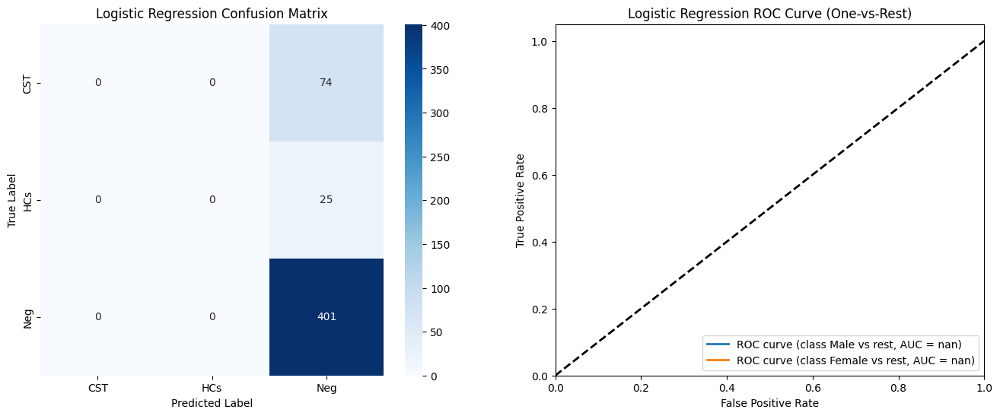

In [116]:
# Cell 4: Logistic Regression
print("\n--- Logistic Regression ---")

# 1. Check if y_train has at least two classes
unique_classes = np.unique(y_train)
if len(unique_classes) < 2:
    print("Error: y_train contains only one class. Logistic Regression requires at least two classes for training.")
    print("Skipping Logistic Regression training for this dataset.")
else:  # Proceed with Logistic Regression training if there are at least two classes
    # 2. Create and Train the Model (Updated)
    lr_model = LogisticRegression(solver='liblinear', random_state=42)
    lr_model.fit(X_train, y_train)

    # 3. Make Predictions
    lr_y_pred = lr_model.predict(X_test)
    lr_y_prob = lr_model.predict_proba(X_test)

    # 4. Evaluate Performance
    print("\nClassification Report:")
    # Get unique classes from y_test
    unique_classes_y_test = np.unique(y_test)
    # Handle potential UndefinedMetricWarning and target_names mismatch
    try:
        print(classification_report(y_test, lr_y_pred,
                                    target_names=[group_map.get(cls, str(cls)) for cls in unique_classes_y_test],
                                    zero_division=1))  # Add zero_division=1
    except ValueError as e:
        print(f"Warning: {e}")
        print("The classification report may be incomplete due to class imbalance.")
    print(f"Accuracy: {accuracy_score(y_test, lr_y_pred):.4f}")

    # Create a figure with two subplots
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # 5. Confusion Matrix
    cm_lr = confusion_matrix(y_test, lr_y_pred)
    sns.heatmap(cm_lr, annot=True, fmt='d', cmap='Blues',
                xticklabels=[group_map.get(cls, str(cls)) for cls in unique_classes_y_test],  # Updated xticklabels
                yticklabels=[group_map.get(cls, str(cls)) for cls in unique_classes_y_test],  # Updated yticklabels
                ax=axes[0])
    axes[0].set_title('Logistic Regression Confusion Matrix')
    axes[0].set_xlabel('Predicted Label')
    axes[0].set_ylabel('True Label')

    # 6. ROC Curve (One-vs-Rest)
    import warnings  # Import warnings module
    n_classes = len(group_map)  # Or len(unique_classes_y_test) for dynamic number of classes
    # Suppress UndefinedMetricWarning
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=UndefinedMetricWarning)
        for i in range(n_classes):
            fpr, tpr, _ = roc_curve(y_test == i, lr_y_prob[:, i])
            roc_auc = auc(fpr, tpr)
            axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')

    axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
    axes[1].set_xlim([0.0, 1.0])
    axes[1].set_ylim([0.0, 1.05])
    axes[1].set_xlabel('False Positive Rate')
    axes[1].set_ylabel('True Positive Rate')
    axes[1].set_title('Logistic Regression ROC Curve (One-vs-Rest)')
    axes[1].legend(loc="lower right")

    plt.show()


--- SVM (Support Vector Machine) ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


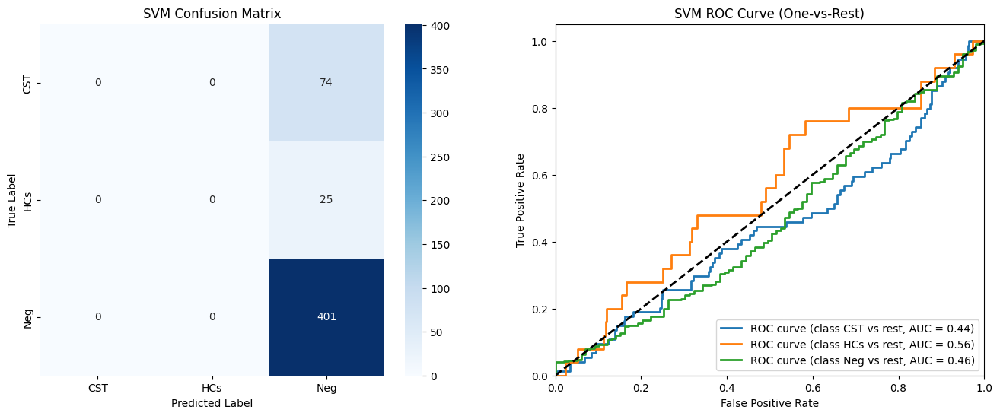

In [119]:
# Cell 5: SVM (Support Vector Machine)
print("\n--- SVM (Support Vector Machine) ---")
svm_model = SVC(probability=True, random_state=42)
svm_model.fit(X_train, y_train)
svm_y_pred = svm_model.predict(X_test)
svm_y_prob = svm_model.predict_proba(X_test)

print("\nClassification Report:")
# Get unique classes from y_test
unique_classes_y_test = np.unique(y_test)
# Update target_names to reflect all unique classes
target_names = [str(cls) for cls in unique_classes_y_test] # Convert to strings if needed
# Add zero_division=1 to handle the warning
print(classification_report(y_test, svm_y_pred, target_names=target_names, zero_division=1))
print(f"Accuracy: {accuracy_score(y_test, svm_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_svm = confusion_matrix(y_test, svm_y_pred)
# Assuming 'unique_classes_y_test' has the correct class labels
sns.heatmap(cm_svm, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])
axes[0].set_title('SVM Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
# Assuming 'svm_y_prob' has probabilities for all unique classes
n_classes = len(unique_classes_y_test)  # Use the actual number of classes in y_test
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], svm_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('SVM ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Decision Tree ---

Classification Report:
              precision    recall  f1-score   support

         CST       0.13      0.14      0.13        74
         HCs       0.05      0.08      0.06        25
         Neg       0.80      0.77      0.79       401

    accuracy                           0.64       500
   macro avg       0.33      0.33      0.33       500
weighted avg       0.67      0.64      0.65       500

Accuracy: 0.6420


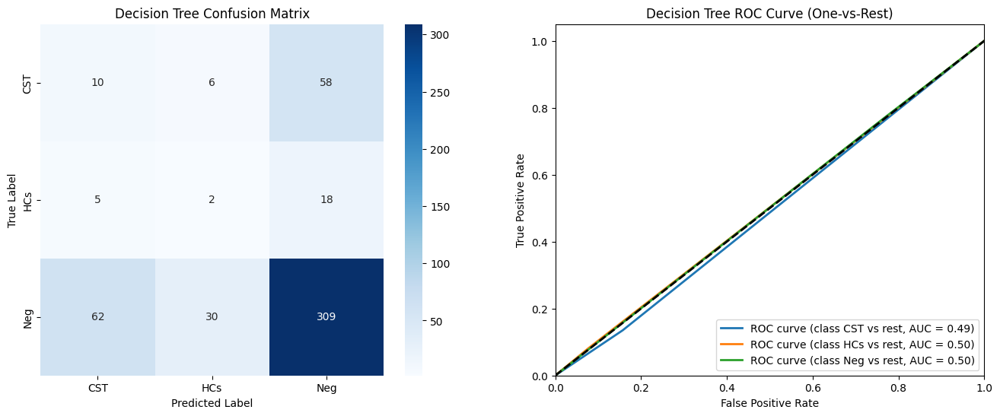

In [121]:
# Cell 6: Decision Tree
print("\n--- Decision Tree ---")
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)
dt_y_pred = dt_model.predict(X_test)
dt_y_prob = dt_model.predict_proba(X_test)

print("\nClassification Report:")
# Get unique classes from y_test
unique_classes_y_test = np.unique(y_test)
# Update target_names to reflect all unique classes in y_test
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
# OR if you want just the string representation:
# target_names = [str(cls) for cls in unique_classes_y_test]
print(classification_report(y_test, dt_y_pred, target_names=target_names))  # Use updated target_names
print(f"Accuracy: {accuracy_score(y_test, dt_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_dt = confusion_matrix(y_test, dt_y_pred)
# Use target_names for xticklabels and yticklabels
sns.heatmap(cm_dt, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])
axes[0].set_title('Decision Tree Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test)  # Use the actual number of unique classes
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], dt_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Decision Tree ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Random Forest ---

Classification Report:
              precision    recall  f1-score   support

         CST       0.33      0.01      0.03        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.71      0.34      0.30       500
weighted avg       0.74      0.80      0.72       500

Accuracy: 0.8000


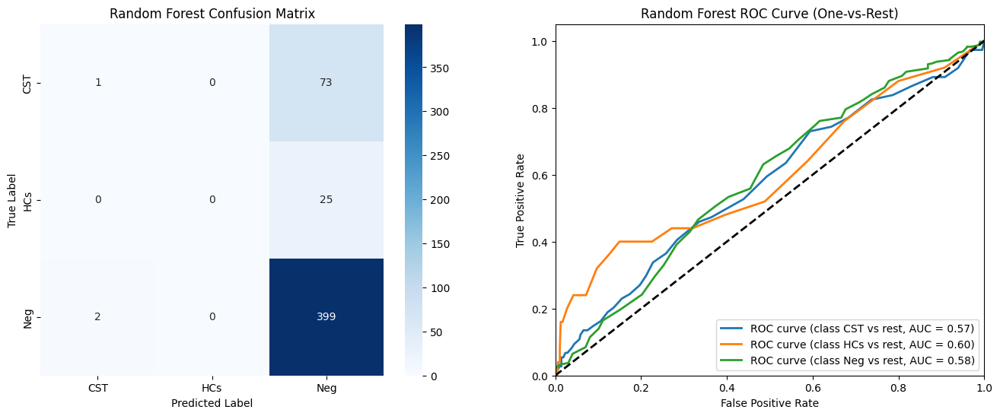

In [123]:
# Cell 7: Random Forest
print("\n--- Random Forest ---")
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)
rf_y_pred = rf_model.predict(X_test)
rf_y_prob = rf_model.predict_proba(X_test)

print("\nClassification Report:")
# Get unique class labels from y_test to ensure all classes are included in the report
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test
target_names = [str(cls) for cls in unique_classes_y_test]
# OR, if you want to map class labels to more descriptive names:
# target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
print(classification_report(y_test, rf_y_pred, target_names=target_names, zero_division=1)) # Added zero_division=1 to handle potential warnings
print(f"Accuracy: {accuracy_score(y_test, rf_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_rf = confusion_matrix(y_test, rf_y_pred)
# Ensure xticklabels and yticklabels match the target_names
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])
axes[0].set_title('Random Forest Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test)  # Use the actual number of unique classes in y_test
# Suppress UndefinedMetricWarning if it occurs
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    for i in range(n_classes):
        fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], rf_y_prob[:, i])
        roc_auc = auc(fpr, tpr)
        axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Random Forest ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- AdaBoost ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


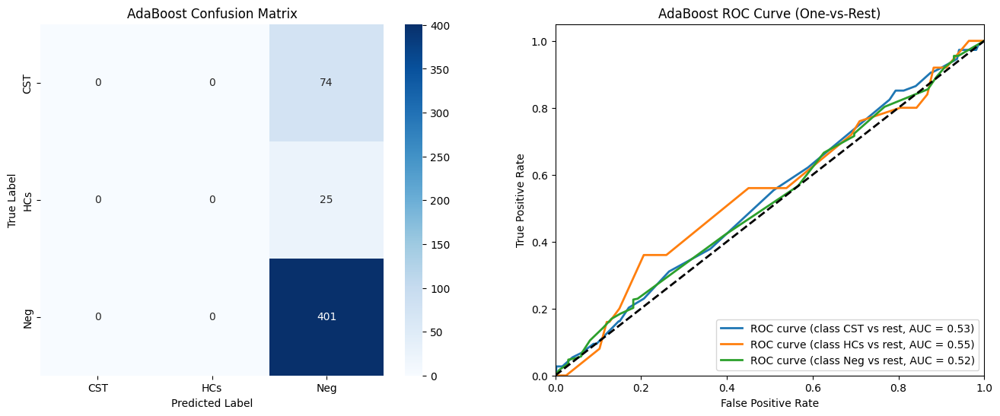

In [126]:
# Cell 8: AdaBoost
print("\n--- AdaBoost ---")
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, roc_auc_score, roc_curve, auc

# Assuming X_train, X_test, y_train, y_test, and group_map are defined in previous cells

# Create and Train the Model
ab_model = AdaBoostClassifier(random_state=42)
ab_model.fit(X_train, y_train)

# Make Predictions
ab_y_pred = ab_model.predict(X_test)
ab_y_prob = ab_model.predict_proba(X_test)

# Evaluate Performance
print("\nClassification Report:")
# Get unique class labels from both y_test and ab_y_pred to handle potential new classes
unique_classes_y_test = np.unique(np.concatenate([y_test, ab_y_pred]))
# Create target_names based on unique class labels, mapping them to descriptive names using group_map
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
# Add zero_division=1 to handle the warning
print(classification_report(y_test, ab_y_pred, target_names=target_names, zero_division=1))
print(f"Accuracy: {accuracy_score(y_test, ab_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Confusion Matrix
cm_ab = confusion_matrix(y_test, ab_y_pred)
sns.heatmap(cm_ab, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])  # Using target_names for labels
axes[0].set_title('AdaBoost Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# ROC Curve (One-vs-Rest)
n_classes = len(unique_classes_y_test)  # Using the number of unique classes
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], ab_y_prob[:, i])  # Comparing against each unique class
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')  # Using target_names for labels

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('AdaBoost ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Naive Bayes ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


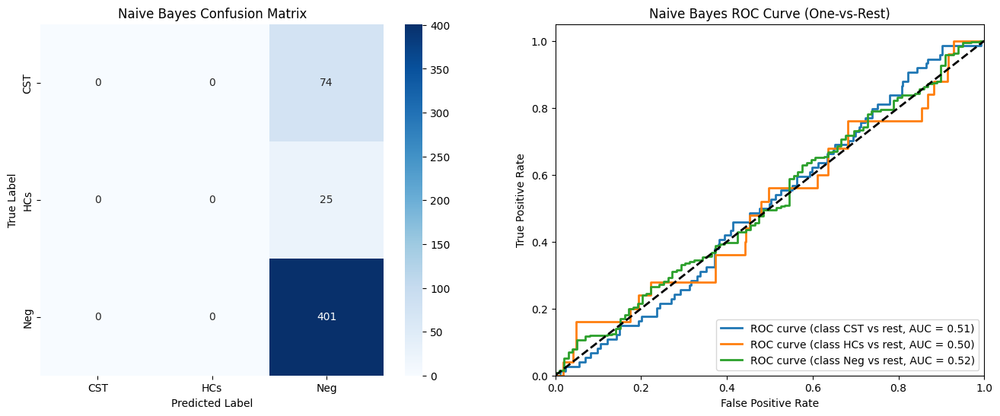

In [128]:
# Cell 9: Naive Bayes
print("\n--- Naive Bayes ---")


# Assuming X_train, X_test, y_train, y_test, and group_map are defined in previous cells

# Create and Train the Model
nb_model = GaussianNB()
nb_model.fit(X_train, y_train)

# Make Predictions
nb_y_pred = nb_model.predict(X_test)
nb_y_prob = nb_model.predict_proba(X_test)

# Evaluate Performance
print("\nClassification Report:")
# Get unique class labels from y_test to ensure all classes are included in the report
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test, using group_map if available
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
print(classification_report(y_test, nb_y_pred, target_names=target_names, zero_division=1)) # Added zero_division=1 to handle potential warnings
print(f"Accuracy: {accuracy_score(y_test, nb_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_nb = confusion_matrix(y_test, nb_y_pred)
# Ensure xticklabels and yticklabels match the target_names
sns.heatmap(cm_nb, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])  # Using target_names for labels
axes[0].set_title('Naive Bayes Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test)  # Use the actual number of unique classes in y_test
# Suppress UndefinedMetricWarning if it occurs
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    for i in range(n_classes):
        fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], nb_y_prob[:, i])
        roc_auc = auc(fpr, tpr)
        axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})') # Using target_names for labels

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Naive Bayes ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- KNN (K-Nearest Neighbors) ---

Classification Report:
              precision    recall  f1-score   support

         CST       0.10      0.03      0.04        74
         HCs       0.25      0.04      0.07        25
         Neg       0.80      0.95      0.87       401

    accuracy                           0.76       500
   macro avg       0.38      0.34      0.33       500
weighted avg       0.67      0.76      0.70       500

Accuracy: 0.7640


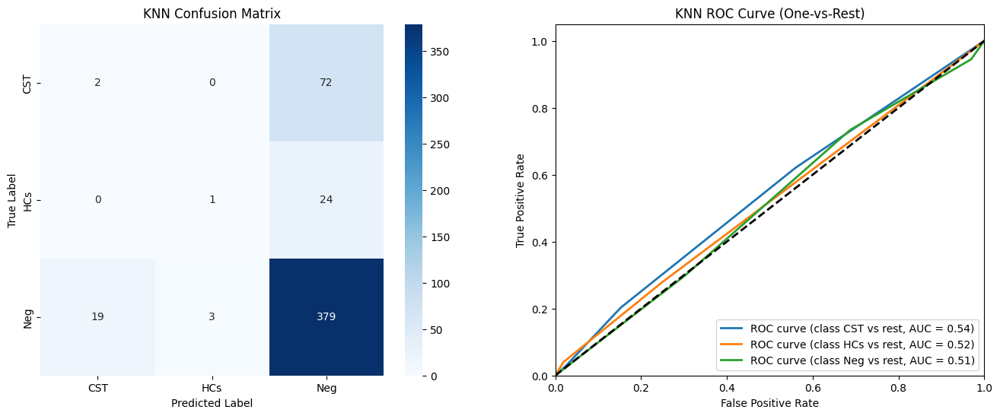

In [131]:
# Cell 10: KNN (K-Nearest Neighbors)
print("\n--- KNN (K-Nearest Neighbors) ---")

# Assuming X_train, X_test, y_train, y_test, and group_map are defined in previous cells

# Create and Train the Model
knn_model = KNeighborsClassifier()
knn_model.fit(X_train, y_train)

# Make Predictions
knn_y_pred = knn_model.predict(X_test)
knn_y_prob = knn_model.predict_proba(X_test)

# Evaluate Performance
print("\nClassification Report:")
# Get unique classes from y_test to ensure all classes are included in the report
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test
# If group_map doesn't have mapping for all unique classes, use str(cls) as fallback
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
print(classification_report(y_test, knn_y_pred, target_names=target_names, zero_division=1)) # Added zero_division=1 to handle potential warnings
print(f"Accuracy: {accuracy_score(y_test, knn_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_knn = confusion_matrix(y_test, knn_y_pred)
# Ensure xticklabels and yticklabels match the target_names
sns.heatmap(cm_knn, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])
axes[0].set_title('KNN Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test)  # Use the actual number of unique classes in y_test
# Suppress UndefinedMetricWarning if it occurs
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    for i in range(n_classes):
        # Check if the current class is in y_test
        if unique_classes_y_test[i] in y_test.unique():
            fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], knn_y_prob[:, i])
            roc_auc = auc(fpr, tpr)
            axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')
        else:
            print(f"Warning: Class {unique_classes_y_test[i]} not found in y_test. Skipping ROC curve for this class.")

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('KNN ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- MLP (Multi-Layer Perceptron) ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


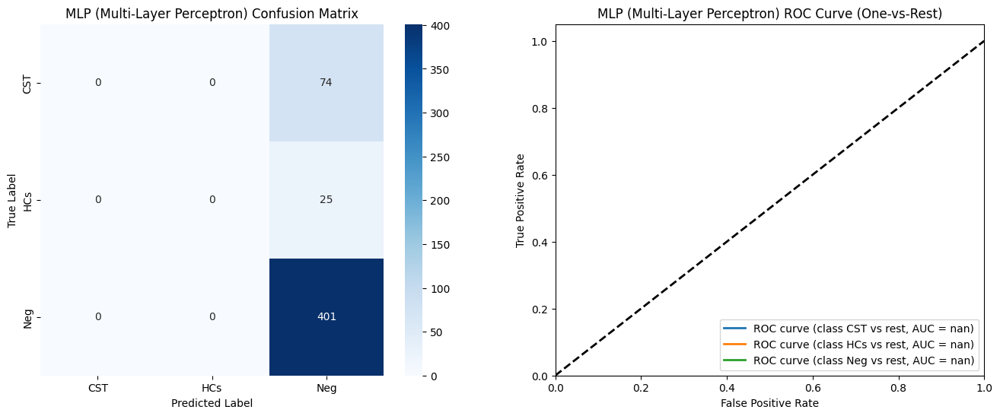

In [135]:
# Cell 11: MLP (Multi-Layer Perceptron)
print("\n--- MLP (Multi-Layer Perceptron) ---")

# Assuming X_train, X_test, y_train, y_test, and group_map are defined in previous cells

# Create a LabelEncoder instance
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()

# Fit the encoder to your training target variable (y_train) and transform it
y_train_encoded = label_encoder.fit_transform(y_train)

# Create and Train the Model using the encoded y_train
mlp_model = MLPClassifier(random_state=42, max_iter=1000, # Increased max_iter
                              early_stopping=True, validation_fraction=0.1)  # Added early stopping
mlp_model.fit(X_train, y_train_encoded)  # Use encoded y_train

# Make Predictions (transform y_test for evaluation)
mlp_y_pred = mlp_model.predict(X_test)
mlp_y_pred = label_encoder.inverse_transform(mlp_y_pred) # Convert back to original labels

mlp_y_prob = mlp_model.predict_proba(X_test)

# Evaluate Performance
print("\nClassification Report:")
# Get unique class labels from y_test
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test, using group_map if available
# If group_map doesn't have mapping for all unique classes, use str(cls) as fallback
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
print(classification_report(y_test, mlp_y_pred, target_names=target_names, zero_division=1)) # Added zero_division=1 to handle warnings
print(f"Accuracy: {accuracy_score(y_test, mlp_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_mlp = confusion_matrix(y_test, mlp_y_pred)
sns.heatmap(cm_mlp, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0]) # Using target_names for labels
axes[0].set_title('MLP (Multi-Layer Perceptron) Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
# Assuming group_map values are the class names
# Get unique classes in y_test again (or use unique_classes_y_test from above)
# unique_classes_y_test = np.unique(y_test)  # If not already defined
n_classes = len(unique_classes_y_test)  # or len(np.unique(y_test))
y_test_encoded = label_encoder.transform(y_test)  # Encode y_test for ROC curve
# Suppress UndefinedMetricWarning if it occurs
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    for i in range(n_classes):
        fpr, tpr, _ = roc_curve(y_test_encoded == unique_classes_y_test[i], mlp_y_prob[:, i])
        roc_auc = auc(fpr, tpr)
        axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})') # Using target_names for labels

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('MLP (Multi-Layer Perceptron) ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- XGBoost ---

Classification Report:
              precision    recall  f1-score   support

         CST       0.21      0.05      0.09        74
         HCs       0.25      0.04      0.07        25
         Neg       0.81      0.96      0.87       401

    accuracy                           0.78       500
   macro avg       0.42      0.35      0.34       500
weighted avg       0.69      0.78      0.72       500

Accuracy: 0.7780


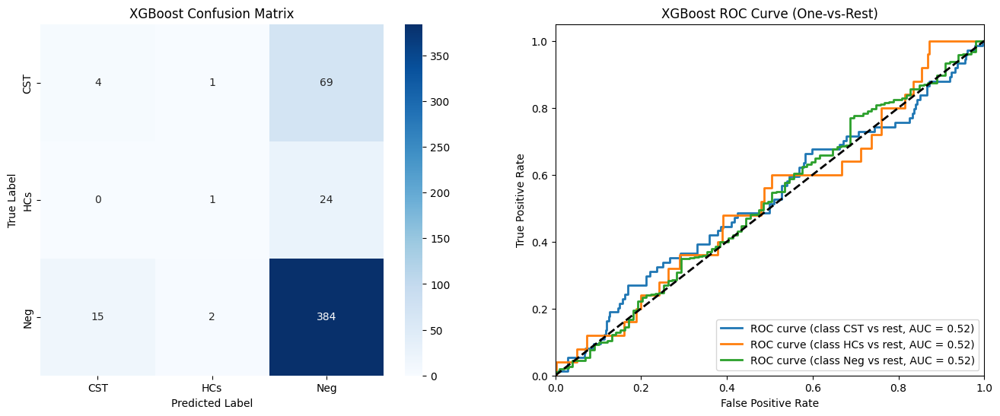

In [137]:
# Cell 12: XGBoost
print("\n--- XGBoost ---")
from sklearn.preprocessing import LabelEncoder # Import LabelEncoder

# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the encoder to your training target variable (y_train) and transform it
y_train_encoded = le.fit_transform(y_train)

# Fit the XGBoost model using the encoded y_train
xgb_model = XGBClassifier(random_state=42, eval_metric='mlogloss')  # Removed use_label_encoder
xgb_model.fit(X_train, y_train_encoded)

# Make predictions (transform y_test for evaluation)
xgb_y_pred = xgb_model.predict(X_test)
xgb_y_pred = le.inverse_transform(xgb_y_pred)  # Convert predictions back to original labels

xgb_y_prob = xgb_model.predict_proba(X_test)

print("\nClassification Report:")
# Get unique class labels from y_test to ensure all classes are included in the report
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test
target_names = [str(cls) for cls in unique_classes_y_test]
# OR, if you want to map class labels to more descriptive names (using group_map):
# target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
print(classification_report(y_test, xgb_y_pred, target_names=target_names, zero_division=1)) # Added zero_division=1 to handle potential warnings
print(f"Accuracy: {accuracy_score(y_test, xgb_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_xgb = confusion_matrix(y_test, xgb_y_pred)
# Ensure xticklabels and yticklabels match the target_names
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names, yticklabels=target_names, ax=axes[0])
axes[0].set_title('XGBoost Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test)  # Use the actual number of unique classes in y_test
# Suppress UndefinedMetricWarning if it occurs
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    for i in range(n_classes):
        fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], xgb_y_prob[:, i])
        roc_auc = auc(fpr, tpr)
        axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')

axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('XGBoost ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Voting Classifier ---

Classification Report:
              precision    recall  f1-score   support

         CST       1.00      0.00      0.00        74
         HCs       1.00      0.00      0.00        25
         Neg       0.80      1.00      0.89       401

    accuracy                           0.80       500
   macro avg       0.93      0.33      0.30       500
weighted avg       0.84      0.80      0.71       500

Accuracy: 0.8020


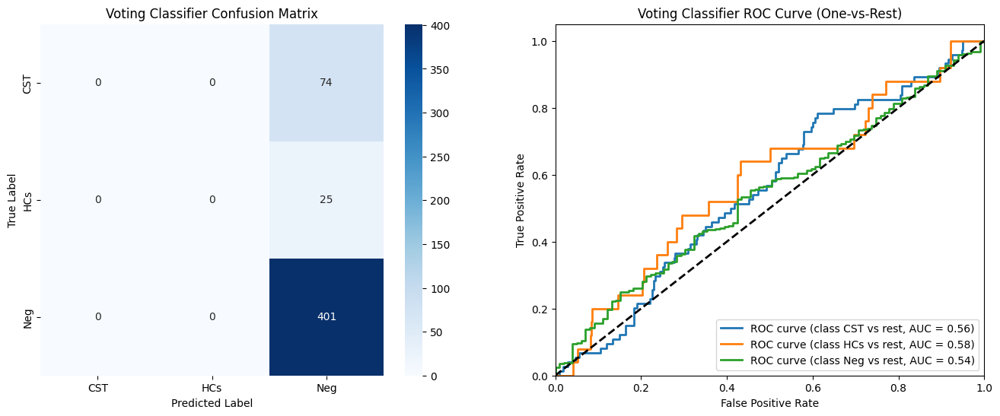

In [140]:
# Cell 13: VotingClassifier
print("\n--- Voting Classifier ---")
from xgboost import XGBClassifier  # Import XGBClassifier
from sklearn.preprocessing import LabelEncoder # Import LabelEncoder

# Create a LabelEncoder instance (if needed for encoding target variable)
le = LabelEncoder()

# If y_train is not numeric, encode it:
if not pd.api.types.is_numeric_dtype(y_train):
    y_train_encoded = le.fit_transform(y_train)
else:
    y_train_encoded = y_train  # No encoding needed

# Create and train the VotingClassifier
vc_model = VotingClassifier(
    estimators=[
        ('lr', LogisticRegression(solver='liblinear', random_state=42)),
        ('svm', SVC(probability=True, random_state=42)),
        ('dt', DecisionTreeClassifier(random_state=42)),
        ('rf', RandomForestClassifier(random_state=42)),
        ('ab', AdaBoostClassifier(random_state=42)),
        ('gnb', GaussianNB()),
        ('knn', KNeighborsClassifier()),
        ('mlp', MLPClassifier(random_state=42, max_iter=1000,
                              early_stopping=True, validation_fraction=0.1)),
        ('xgb', XGBClassifier(random_state=42, eval_metric='mlogloss'))
    ],
    voting='soft'
)

vc_model.fit(X_train, y_train_encoded)  # Use encoded y_train if encoding was done

# Make predictions
vc_y_pred = vc_model.predict(X_test)

# If encoding was done, decode the predictions:
if not pd.api.types.is_numeric_dtype(y_train):
    vc_y_pred = le.inverse_transform(vc_y_pred)

vc_y_prob = vc_model.predict_proba(X_test)

# Evaluate Performance
print("\nClassification Report:")
# Get unique class labels from y_test to ensure all classes are included in the report
unique_classes_y_test = np.unique(y_test)
# Create target_names based on unique class labels in y_test
target_names = [group_map.get(cls, str(cls)) for cls in unique_classes_y_test]
# If group_map doesn't have mapping for all unique classes, use str(cls) as fallback
print(classification_report(y_test, vc_y_pred, target_names=target_names, zero_division=1))
print(f"Accuracy: {accuracy_score(y_test, vc_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_vc = confusion_matrix(y_test, vc_y_pred)
sns.heatmap(cm_vc, annot=True, fmt='d', cmap='Blues',
            xticklabels=target_names,
            yticklabels=target_names, ax=axes[0])
axes[0].set_title('Voting Classifier Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(unique_classes_y_test) # Number of unique classes in y_test
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == unique_classes_y_test[i], vc_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2,
                 label=f'ROC curve (class {target_names[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Voting Classifier ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

# Display the figure with both subplots
plt.show()


--- Logistic Regression Feature Importance and LIME ---

Feature Importance (Absolute Coefficients):
  Feature  Importance
4    Iron    0.069218
3     RBC    0.060275
0     MCV    0.048000
2     MCH    0.047471
1     HBG    0.046259


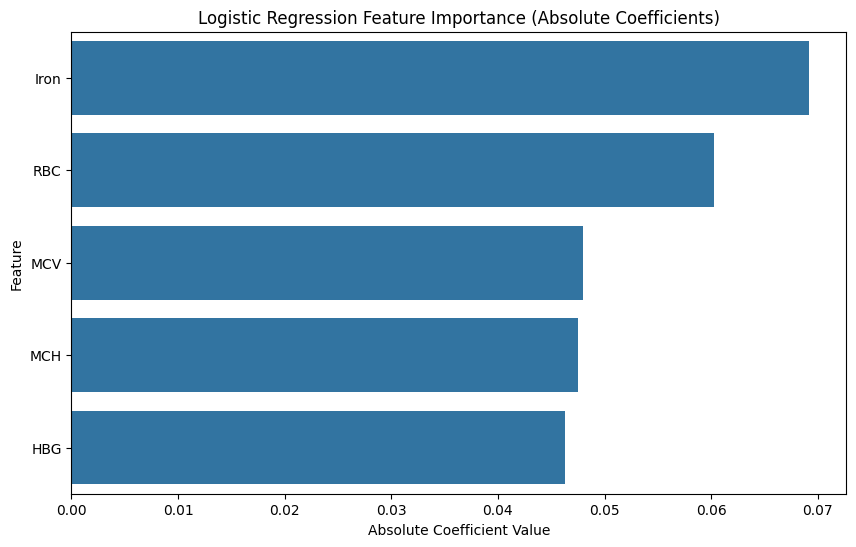


LIME Explanation (Instance 0):


In [142]:
# Cell 14: Logistic Regression Feature Importance and LIME

print("\n--- Logistic Regression Feature Importance and LIME ---")
if hasattr(lr_model, 'coef_'):
    importance_lr = np.abs(lr_model.coef_[0]) # For binary or OvR
    feature_importance_lr = pd.DataFrame({'Feature': important_features, 'Importance': importance_lr})
    feature_importance_lr = feature_importance_lr.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance (Absolute Coefficients):")
    print(feature_importance_lr)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_lr)
    plt.title('Logistic Regression Feature Importance (Absolute Coefficients)')
    plt.xlabel('Absolute Coefficient Value')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Logistic Regression model does not have 'coef_' attribute for feature importance.")

try:
    explainer_lime_lr = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_lr = explainer_lime_lr.explain_instance(X_test[0], lr_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_lr.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Logistic Regression: {e}")


--- SVM Feature Importance and LIME ---

Feature Importance (Permutation Importance):
  Feature  Importance
0     MCV         0.0
1     HBG         0.0
2     MCH         0.0
3     RBC         0.0
4    Iron         0.0


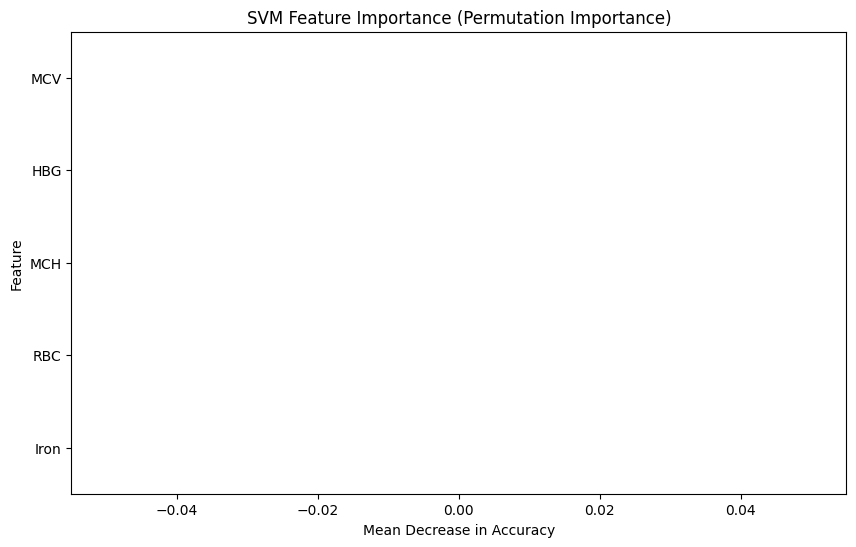


LIME Explanation (Instance 0):


In [146]:
# Cell 15: SVM Feature Importance and LIME
print("\n--- SVM Feature Importance and LIME ---")
from sklearn.inspection import permutation_importance

# 1. Feature Importance (Permutation Importance)
result_svm = permutation_importance(svm_model, X_test, y_test, n_repeats=10, random_state=42)
importance_svm = result_svm.importances_mean
feature_importance_svm = pd.DataFrame({'Feature': important_features, 'Importance': importance_svm})
feature_importance_svm = feature_importance_svm.sort_values(by='Importance', ascending=False)
print("\nFeature Importance (Permutation Importance):")
print(feature_importance_svm)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_svm)
plt.title('SVM Feature Importance (Permutation Importance)')
plt.xlabel('Mean Decrease in Accuracy')
plt.ylabel('Feature')
plt.show()

# 2. LIME Explanation
try:
    explainer_lime_svm = lime.lime_tabular.LimeTabularExplainer(
        X_train,
        feature_names=important_features,
        class_names=list(group_map.values()),
        mode='classification',
        # Added parameters for potential improvement:
        kernel_width=0.75,  # Adjust kernel width (try different values)
        discretize_continuous=True,  # Discretize continuous features
        feature_selection='auto'  # Use automatic feature selection
    )

    explanation_svm = explainer_lime_svm.explain_instance(
        X_test[0],
        svm_model.predict_proba,
        num_features=len(important_features),
        # Added parameter for potential improvement:
        top_labels=3  # Show explanations for top 3 predicted classes
    )

    print("\nLIME Explanation (Instance 0):")
    explanation_svm.show_in_notebook(show_table=True, show_all=False)

except Exception as e:
    print(f"Error generating LIME report for SVM: {e}")


--- Decision Tree Feature Importance and LIME ---

Feature Importance:
  Feature  Importance
3     RBC    0.264016
4    Iron    0.233193
2     MCH    0.229228
0     MCV    0.216964
1     HBG    0.056599


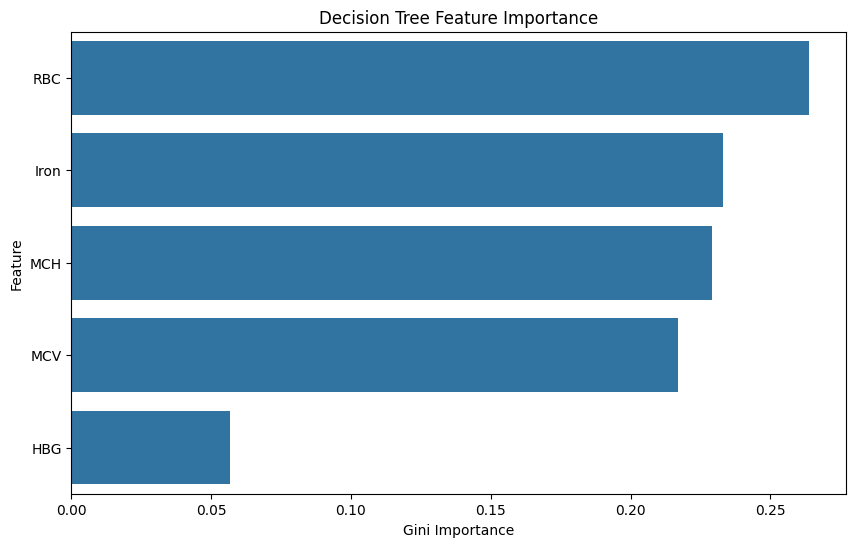


LIME Explanation (Instance 0):


In [147]:
# Cell 16: Decision Tree Feature Importance and LIME
print("\n--- Decision Tree Feature Importance and LIME ---")
if hasattr(dt_model, 'feature_importances_'):
    importance_dt = dt_model.feature_importances_
    feature_importance_dt = pd.DataFrame({'Feature': important_features, 'Importance': importance_dt})
    feature_importance_dt = feature_importance_dt.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_dt)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_dt)
    plt.title('Decision Tree Feature Importance')
    plt.xlabel('Gini Importance')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Decision Tree model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_dt = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_dt = explainer_lime_dt.explain_instance(X_test[0], dt_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_dt.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Decision Tree: {e}")


--- Random Forest Feature Importance and LIME ---

Feature Importance:
  Feature  Importance
3     RBC    0.268638
4    Iron    0.246908
2     MCH    0.234930
0     MCV    0.209501
1     HBG    0.040023


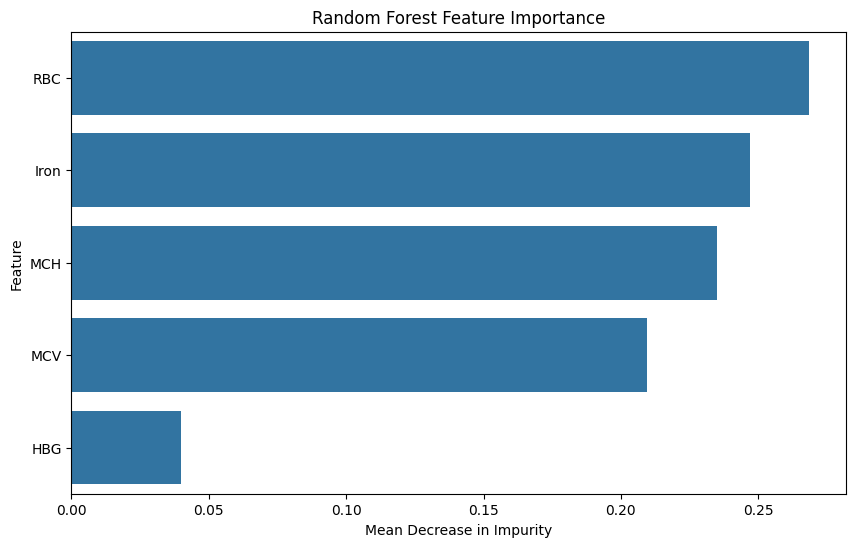


LIME Explanation (Instance 0):


In [148]:
# Cell 17: Random Forest Feature Importance and LIME
print("\n--- Random Forest Feature Importance and LIME ---")
if hasattr(rf_model, 'feature_importances_'):
    importance_rf = rf_model.feature_importances_
    feature_importance_rf = pd.DataFrame({'Feature': important_features, 'Importance': importance_rf})
    feature_importance_rf = feature_importance_rf.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_rf)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_rf)
    plt.title('Random Forest Feature Importance')
    plt.xlabel('Mean Decrease in Impurity')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Random Forest model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_rf = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_rf = explainer_lime_rf.explain_instance(X_test[0], rf_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_rf.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Random Forest: {e}")


--- AdaBoost Feature Importance and LIME ---

Feature Importance:
  Feature  Importance
3     RBC    0.393474
4    Iron    0.274738
0     MCV    0.262507
2     MCH    0.069282
1     HBG    0.000000


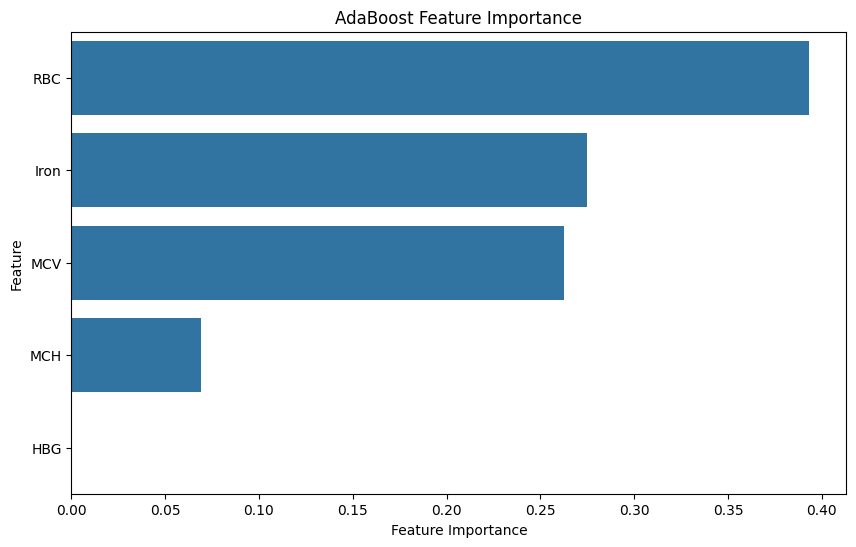


LIME Explanation (Instance 0):


In [152]:
# Cell 18: AdaBoost Feature Importance and LIME
print("\n--- AdaBoost Feature Importance and LIME ---")
if hasattr(ab_model, 'feature_importances_'):
    importance_ab = ab_model.feature_importances_
    feature_importance_ab = pd.DataFrame({'Feature': important_features, 'Importance': importance_ab})
    feature_importance_ab = feature_importance_ab.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_ab)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_ab)
    plt.title('AdaBoost Feature Importance')
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature')
    plt.show()
else:
    print("AdaBoost model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_ab = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_ab = explainer_lime_ab.explain_instance(X_test[0], ab_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_ab.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for AdaBoost: {e}")

In [150]:
# Cell 19: Naive Bayes Feature Importance and LIME
print("\n--- Naive Bayes Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for Naive Bayes.")



result = permutation_importance(nb_model, X_test, y_test, n_repeats=10, random_state=42)
importance = result.importances_mean
feature_importance = pd.DataFrame({'Feature': important_features, 'Importance': importance})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print("\nPermutation Feature Importance:")
print(feature_importance)

# 2. LIME Explanation
try:
    explainer_lime_nb = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_nb = explainer_lime_nb.explain_instance(X_test[0], nb_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_nb.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Naive Bayes: {e}")


--- Naive Bayes Feature Importance and LIME ---

Feature importance is not directly interpretable for Naive Bayes.

Permutation Feature Importance:
  Feature  Importance
0     MCV         0.0
1     HBG         0.0
2     MCH         0.0
3     RBC         0.0
4    Iron         0.0

LIME Explanation (Instance 0):


In [153]:
# Cell 20: KNN Feature Importance and LIME
print("\n--- KNN Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for KNN.")
try:
    explainer_lime_knn = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_knn = explainer_lime_knn.explain_instance(X_test[0], knn_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_knn.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for KNN: {e}")


--- KNN Feature Importance and LIME ---

Feature importance is not directly interpretable for KNN.

LIME Explanation (Instance 0):



--- MLP Feature Importance and LIME ---

Feature Importance (Permutation Importance):
  Feature  Importance
0     MCV         0.0
1     HBG         0.0
2     MCH         0.0
3     RBC         0.0
4    Iron         0.0


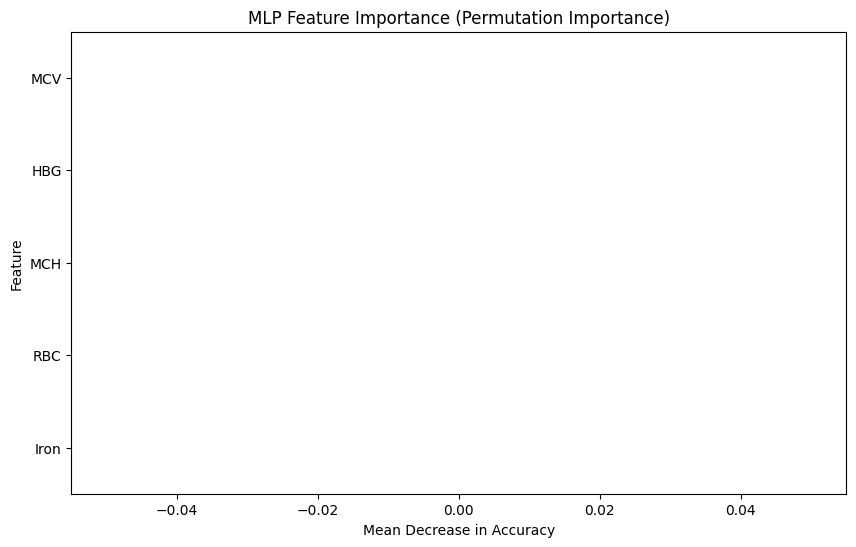


LIME Explanation (Instance 0):


In [154]:
# Cell 21: MLP Feature Importance and LIME
print("\n--- MLP Feature Importance and LIME ---")
result_mlp = permutation_importance(mlp_model, X_test, y_test, n_repeats=10, random_state=42)
importance_mlp = result_mlp.importances_mean
feature_importance_mlp = pd.DataFrame({'Feature': important_features, 'Importance': importance_mlp})
print("\nFeature Importance (Permutation Importance):")
print(feature_importance_mlp)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_mlp)
plt.title('MLP Feature Importance (Permutation Importance)')
plt.xlabel('Mean Decrease in Accuracy')
plt.ylabel('Feature')
plt.show()

try:
    explainer_lime_mlp = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_mlp = explainer_lime_mlp.explain_instance(X_test[0], mlp_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_mlp.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for MLP: {e}")


--- XGBoost Feature Importance and LIME ---

Feature Importance:
  Feature  Importance
0     MCV    0.215873
1     HBG    0.177606
2     MCH    0.188497
3     RBC    0.208797
4    Iron    0.209228


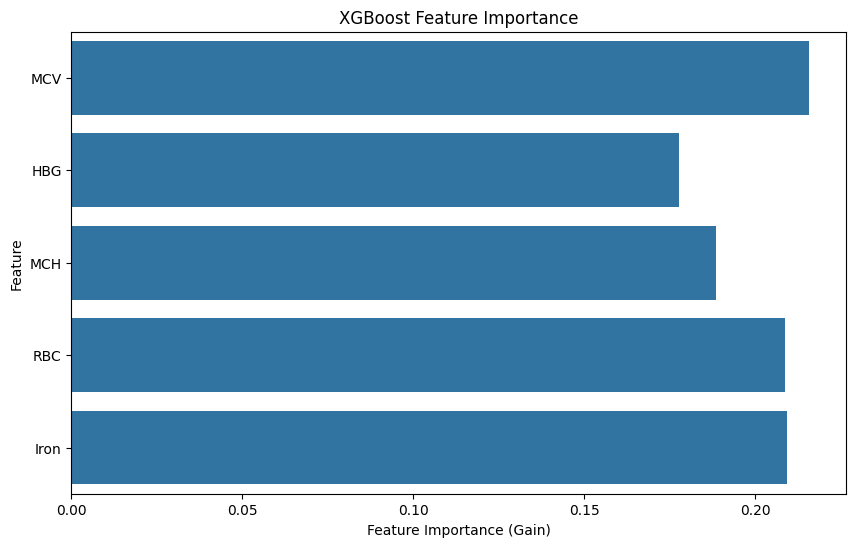


LIME Explanation (Instance 0):


In [155]:
# Cell 22: XGBoost Feature Importance and LIME
print("\n--- XGBoost Feature Importance and LIME ---")
if hasattr(xgb_model, 'feature_importances_'):
    importance_xgb = xgb_model.feature_importances_
    feature_importance_xgb = pd.DataFrame({'Feature': important_features, 'Importance': importance_xgb})
    print("\nFeature Importance:")
    print(feature_importance_xgb)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_xgb)
    plt.title('XGBoost Feature Importance')
    plt.xlabel('Feature Importance (Gain)')
    plt.ylabel('Feature')
    plt.show()
else:
    print("XGBoost model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_xgb = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_xgb = explainer_lime_xgb.explain_instance(X_test[0], xgb_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_xgb.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for XGBoost: {e}")

In [156]:
# Cell 23: VotingClassifier Feature Importance and LIME
print("\n--- Voting Classifier Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for a VotingClassifier.")
try:
    explainer_lime_vc = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_vc = explainer_lime_vc.explain_instance(X_test[0], vc_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_vc.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for VotingClassifier: {e}")


--- Voting Classifier Feature Importance and LIME ---

Feature importance is not directly interpretable for a VotingClassifier.

LIME Explanation (Instance 0):



--- Algorithm Performance Summary (Accuracy and Error) ---
                    Accuracy Error Rate
Logistic Regression   0.8020     0.1980
SVM                   0.8020     0.1980
Decision Tree         0.6420     0.3580
Random Forest         0.8000     0.2000
AdaBoost              0.8020     0.1980
Naive Bayes           0.8020     0.1980
KNN                   0.7640     0.2360
MLP                   0.0000     1.0000
XGBoost               0.0000     1.0000
Voting Classifier     0.0000     1.0000


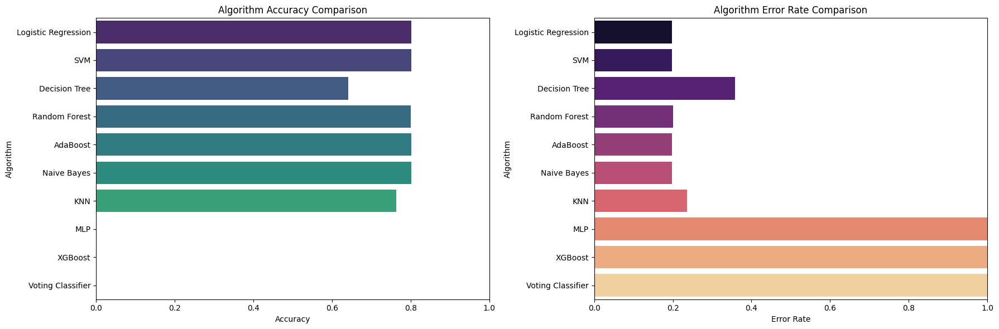

In [157]:
# Cell 24: Algorithm Performance Summary (Accuracy and Error)
print("\n--- Algorithm Performance Summary (Accuracy and Error) ---")

# 1. Create a dictionary to store the trained models
trained_models = {
    'Logistic Regression': lr_model,
    'SVM': svm_model,
    'Decision Tree': dt_model,
    'Random Forest': rf_model,
    'AdaBoost': ab_model,
    'Naive Bayes': nb_model,
    'KNN': knn_model,
    'MLP': mlp_model,
    'XGBoost': xgb_model,
    'Voting Classifier': vc_model  # Add the VotingClassifier
}

# 2. Calculate and store performance metrics
performance_summary = {}
for name, model in trained_models.items():
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    error_rate = 1 - accuracy
    performance_summary[name] = {'Accuracy': f'{accuracy:.4f}', 'Error Rate': f'{error_rate:.4f}'}

# 3. Create a DataFrame for easy viewing
performance_df = pd.DataFrame.from_dict(performance_summary, orient='index')
print(performance_df)

# 4. Create lists for accuracy and error rate values
accuracies = [float(v['Accuracy']) for v in performance_summary.values()]
error_rates = [float(v['Error Rate']) for v in performance_summary.values()]
model_names = list(performance_summary.keys())  # Get model names

# 5. Visualize Accuracy and Error Rate in Subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 6))  # Create a figure with 2 subplots

# Accuracy Subplot
sns.barplot(x=accuracies, y=model_names, hue=model_names, palette='viridis', dodge=False, legend=False, ax=axes[0])  # Updated
axes[0].set_title('Algorithm Accuracy Comparison')
axes[0].set_xlabel('Accuracy')
axes[0].set_ylabel('Algorithm')
axes[0].set_xlim(0, 1)

# Error Rate Subplot
sns.barplot(x=error_rates, y=model_names, hue=model_names, palette='magma', dodge=False, legend=False, ax=axes[1])  # Updated
axes[1].set_title('Algorithm Error Rate Comparison')
axes[1].set_xlabel('Error Rate')
axes[1].set_ylabel('Algorithm')
axes[1].set_xlim(0, 1)

# Display the figure with both subplots
plt.tight_layout()  # Adjust layout for better spacing
plt.show()